In [78]:
import os, shutil
from tqdm import tqdm
import torch
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
import random
import torch

# Randomly Smaple from Dataset

(Don't run this unless you want to resample from the dataset)

In [9]:
root = '/data5/drone_machinelearning/amir/pix3d/'
all_img = []
for c in os.listdir(os.path.join(root, 'img')):
    for filename in os.listdir(os.path.join(root, 'img', c)):
        all_img.append((c, filename))
demo_img = random.sample(all_img, 100)
tgt = '/data5/drone_machinelearning/amir/ece285_alip/demo_img'
for c, f in demo_img:
    f, ext = os.path.splitext(f)
    for folder in ['img', 'mask', 'render']:
        if not os.path.exists(os.path.join(tgt, folder)):
            os.mkdir(os.path.join(tgt, folder))
        name = f + (ext if folder == 'img' else '.png')
        shutil.copyfile(os.path.join(root, folder, c, name), os.path.join(tgt, folder, c+'_'+name))

# Demo

Change the following to demo the generator trained under different configuration.

In [92]:
D_arch = 'NLayer'
Loss = 'MSE'

In [93]:
from Arch import UNet
model = UNet(input_nc=3)
model.load_state_dict(torch.load('demo_model/Demo_Generator_'+D_arch+'_'+Loss+'.pt'))
if torch.cuda.is_available():
    model = model.cuda()

In [81]:
from torchvision import transforms
transform = transforms.Compose([
            transforms.Resize((256,256)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ])

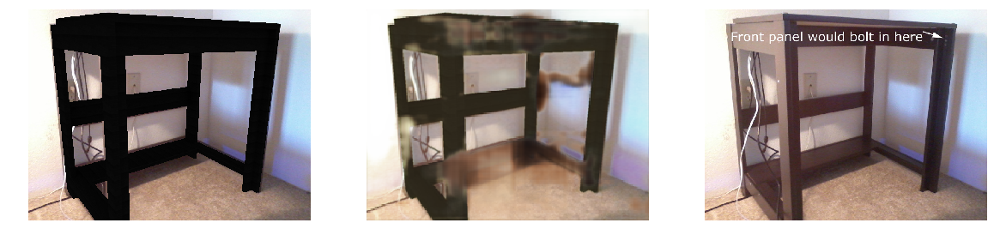

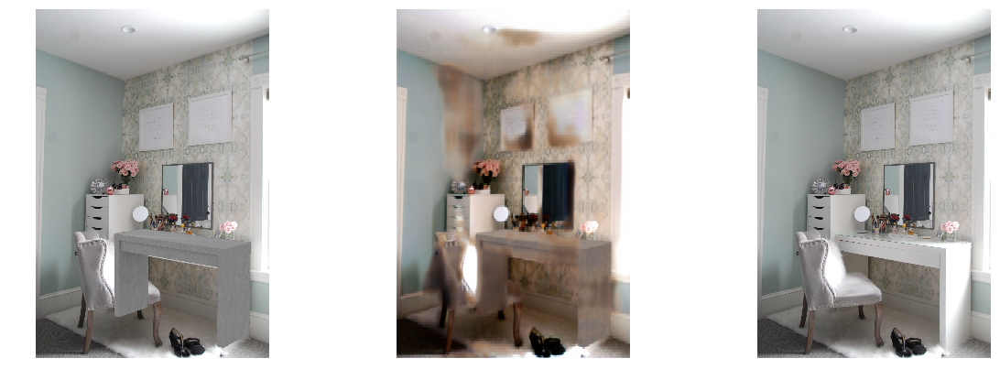

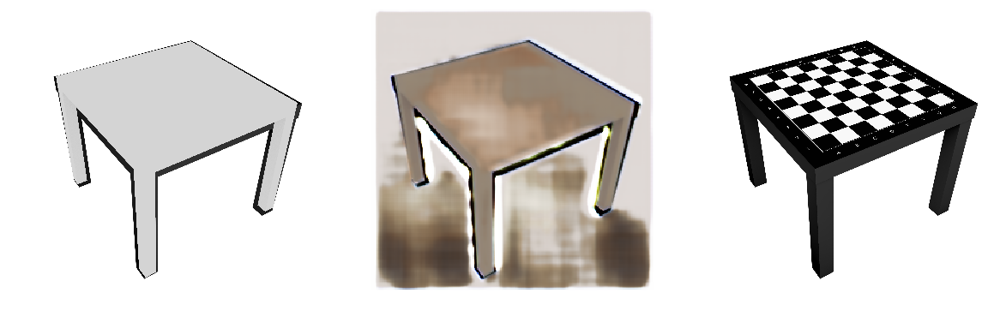

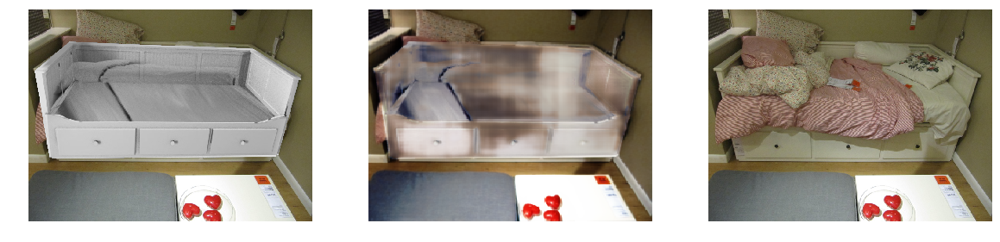

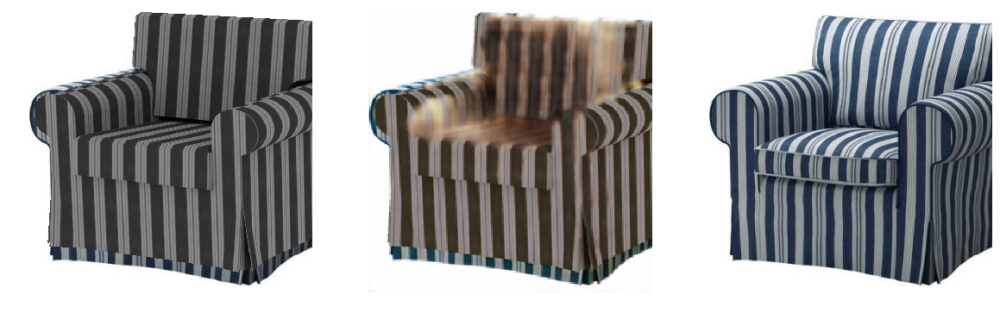

...

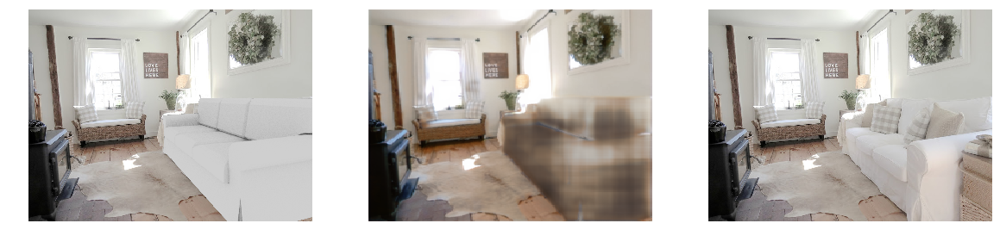

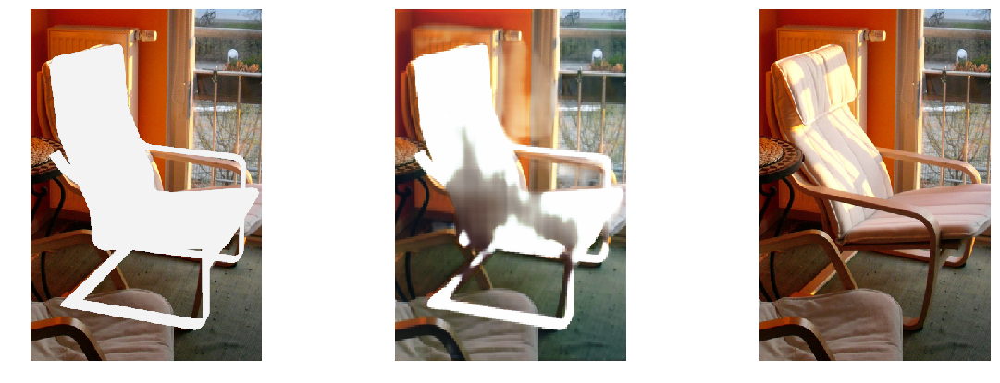

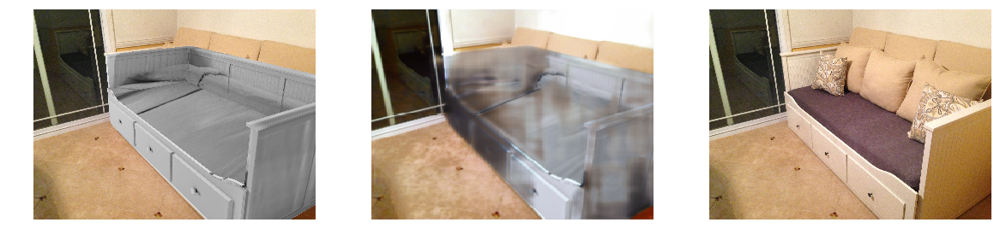

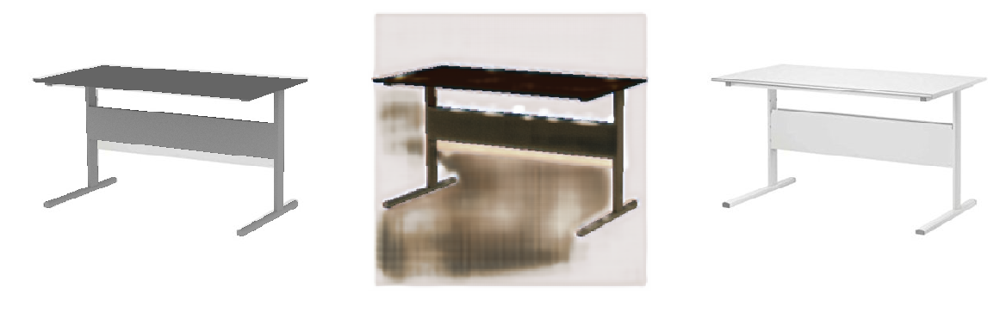

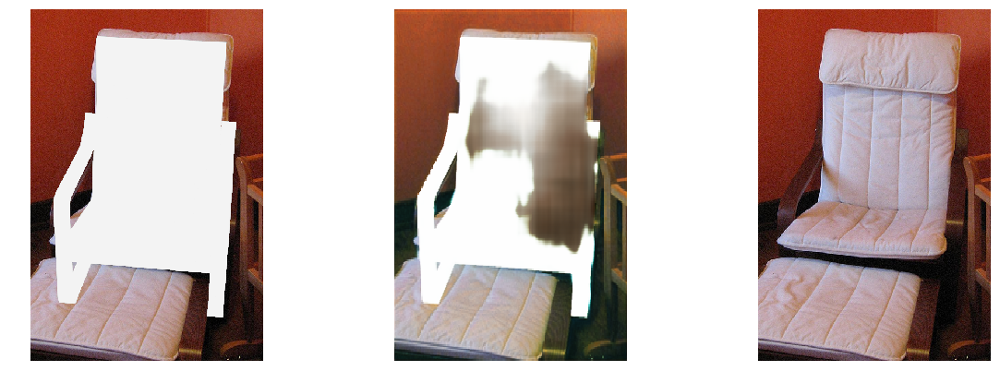

In [91]:
from PIL import Image
toPIL = transforms.ToPILImage()
for filename in os.listdir(os.path.join('demo_img', 'img')):
    f, ext = os.path.splitext(filename)
    ori = Image.open(os.path.join('demo_img', 'img', filename)).convert('RGB')
    mask = Image.open(os.path.join('demo_img', 'mask', f+'.png'))
    syn = Image.open(os.path.join('demo_img', 'render', f+'.png')).convert('L').convert('RGB')
    
    plt.figure(figsize=(20,7))
    plt.subplot(1,3,3)
    plt.imshow(ori)
    plt.axis('off')
    
    ori.paste(syn, mask=mask)
    input = transform(ori)
    input = torch.unsqueeze(input, 0).cuda()
    output = model(input).cpu().data.squeeze()
    output = toPIL(output).resize(ori.size)
    
    plt.subplot(1,3,1)
    plt.imshow(ori)
    plt.axis('off')
    
    plt.subplot(1,3,2)
    plt.imshow(output)
    plt.axis('off')
    plt.show()